# **Spain data**

Running this notebook does not require a GPU. You can use a frontal node. However, certain parts such as detecting bounding boxes or removing the background from images require GPUs which are launched in external jobs.

In [1]:
# Allow reloading of libraries without restarting the kernel
%load_ext autoreload
%autoreload 2

In [4]:
import os
import re
import json
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

from PIL import Image
from pathlib import Path

from lynx_id.utils.preprocess.utils import segmentation_inversion, check_filepath, flatten_bbox, get_no_and_multiple_bbox, separate_single_multiple_df, plot_images_conf, absolute_coordinates_bbox
from lynx_id.utils.megadetector.utils import crop_bbox

from idr_pytools import display_slurm_queue, gpu_jobs_submitter, search_log
from megadetector.detection.run_detector_batch import load_and_run_detector_batch, write_results_to_file
from megadetector.utils import path_utils

os.environ['WANDB_DISABLED'] = 'true'  # for megadetector

In [5]:
# GPU parameters for jobs to be launched (MegaDetector + SAM)
MODULE = 'pytorch-gpu/py3/2.2.0'
account = 'ads@v100'

In [6]:
DATASET = Path("/gpfsscratch/rech/ads/commun/datasets/extracted/")
COUNTRY = "spain"
SPAIN_DATASET_PATH = DATASET / "spain/data"
NO_BACKGROUND = Path("/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new")

---

## **Get images (filepath + lynx_id)**

In [5]:
dataset_dict = {
    "filepath": [],
    "lynx_id": [],
}

In [6]:
cnt_img = 0
cnt_convention_lynxid_number = 0
cnt_convention_lynxid_side_number = 0
cnt_unusable = 0

regex_lynxid_number = re.compile(r'^(\w+)\s+\(\d+\)\.', re.IGNORECASE)
regex_lynxid_side_number = re.compile(r'^(\w+)_[dDiI]\d+\.', re.IGNORECASE)

for current_directory, _, files in os.walk(SPAIN_DATASET_PATH):
    for file in files:
        absolute_path = Path(os.path.abspath(os.path.join(current_directory, file)))
        
        # check that the current file is an image
        if re.compile(r'\.(jpg|jpeg|png|tif)$', re.IGNORECASE).search(absolute_path.suffix):
            cnt_img += 1

            match_lynxid_number = regex_lynxid_number.search(file)
            match_lynxid_side_number = regex_lynxid_side_number.search(file)
            if match_lynxid_number:
                cnt_convention_lynxid_number += 1
                lynx_id = match_lynxid_number.group(1)
                # print(lynx_id, "|", file)
                dataset_dict["filepath"].append(str(absolute_path))
                dataset_dict["lynx_id"].append(lynx_id)
                
            elif match_lynxid_side_number:
                cnt_convention_lynxid_side_number += 1
                lynx_id = match_lynxid_side_number.group(1)
                # print(lynx_id, "|", file)
                dataset_dict["filepath"].append(str(absolute_path))
                dataset_dict["lynx_id"].append(lynx_id)
                
            else:
                cnt_unusable += 1
                # print(file)
                
print(f"Total number of images in the spanish dataset: {cnt_img}")
print(f"{cnt_convention_lynxid_number=}")
print(f"{cnt_convention_lynxid_side_number=}")
print(f"{cnt_unusable=}")

Total number of images in the spanish dataset: 1638
cnt_convention_lynxid_number=1394
cnt_convention_lynxid_side_number=202
cnt_unusable=42


In [7]:
df_country = pd.DataFrame(dataset_dict)
df_country

,filepath,lynx_id
0,/gpfsscratch/rech/ads/commun/datasets/extracte...,Arce
1,/gpfsscratch/rech/ads/commun/datasets/extracte...,Mural
2,/gpfsscratch/rech/ads/commun/datasets/extracte...,Betis
3,/gpfsscratch/rech/ads/commun/datasets/extracte...,NinfaMt
4,/gpfsscratch/rech/ads/commun/datasets/extracte...,Mosto
...,...,...
1591,/gpfsscratch/rech/ads/commun/datasets/extracte...,Arce
1592,/gpfsscratch/rech/ads/commun/datasets/extracte...,Piqueros
1593,/gpfsscratch/rech/ads/commun/datasets/extracte...,RELICTO
1594,/gpfsscratch/rech/ads/commun/datasets/extracte...,Brinco


In [8]:
df_country.nunique()

filepath    1596
lynx_id      187
dtype: int64

## **Bounding box detection**

In [9]:
country_output_megadetector = DATASET / COUNTRY / f"bbox_{COUNTRY}.json"  # WARNING: change filename if needed
country_output_megadetector

In [10]:
image_filenames = df_country['filepath'].tolist()
len(image_filenames)

1596

In [12]:
display_slurm_queue(name=f"megadetector_{COUNTRY}", timestep=60)

             JOBID PARTITION     NAME     USER ST       TIME  NODES NODELIST(REASON)
            324971   gpu_p13 megadete  uxp55sd  R       3:56      1 r6i6n1

 Done!


In [13]:
with open(country_output_megadetector, 'r') as f:
    bbox_country = json.load(f)

Some images may not have bounding boxes found.

In [14]:
no_bbox_country, multiple_bbox_country = get_no_and_multiple_bbox(bbox_country)

13 images have no bounding boxes detected.
47 images have several bounding boxes detected.
Total: 1596 images.


Absolute coordinates of the bounding box (x, y, width and height) based on the image dimensions

In [15]:
df_bbox_country = flatten_bbox(bbox_country, add_image_without_bbox=False, verbose=False)
df_bbox_country = absolute_coordinates_bbox(df_bbox_country)

df_bbox_country

,file,im_width,im_height,category,conf,x,y,width,height
0,/gpfsscratch/rech/ads/commun/datasets/extracte...,2560,1920,1,0.964,1342.976000,557.95200,890.8800,586.9440
1,/gpfsscratch/rech/ads/commun/datasets/extracte...,4608,2560,1,0.979,432.967680,0.00000,3847.6800,2487.8080
2,/gpfsscratch/rech/ads/commun/datasets/extracte...,1944,1458,1,0.964,385.884000,84.98682,630.8280,524.8800
3,/gpfsscratch/rech/ads/commun/datasets/extracte...,1002,762,1,0.951,20.991900,252.98400,933.9642,503.9868
4,/gpfsscratch/rech/ads/commun/datasets/extracte...,2560,1920,1,0.956,278.784000,315.84000,2185.9840,1411.9680
...,...,...,...,...,...,...,...,...,...
1630,/gpfsscratch/rech/ads/commun/datasets/extracte...,1280,720,1,0.956,334.976000,209.95200,419.9680,214.9920
1631,/gpfsscratch/rech/ads/commun/datasets/extracte...,853,754,1,0.826,73.997750,14.99706,774.9505,733.9436
1632,/gpfsscratch/rech/ads/commun/datasets/extracte...,1544,1024,1,0.511,0.999894,912.99840,295.9848,109.9776
1633,/gpfsscratch/rech/ads/commun/datasets/extracte...,1544,1024,1,0.953,418.887200,577.94560,482.9632,325.9392


In [16]:
df_bbox_country.nunique()['file']

1583

### **10 images cropped with the least confidence are displayed**

Only images with a single bounding box are displayed.

In [17]:
df_bbox_country_single_detection, df_bbox_country_multiple_detections = separate_single_multiple_df(df_bbox_country)

print(len(df_bbox_country_single_detection))
print(len(df_bbox_country_multiple_detections))

1536
99


In [18]:
%matplotlib inline

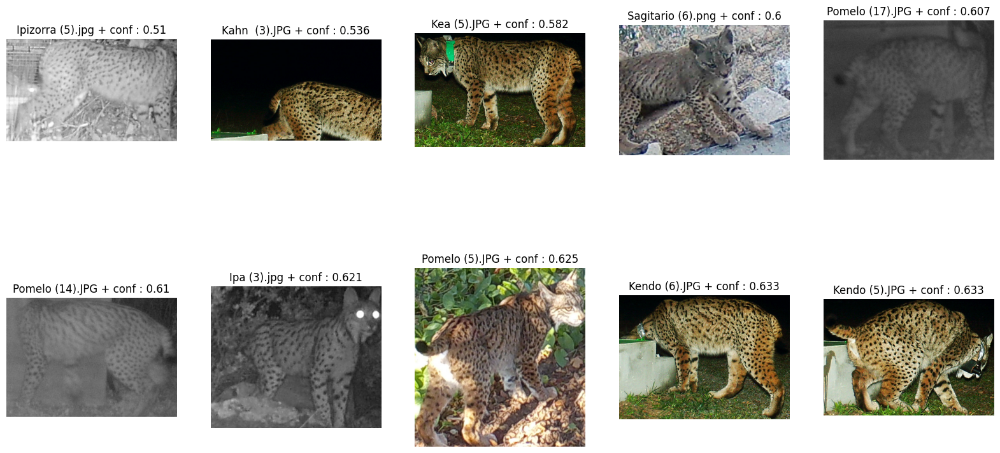

In [19]:
plot_images_conf(df_bbox_country_single_detection, by="smallest")

### **10 images cropped with the largest confidence are displayed**

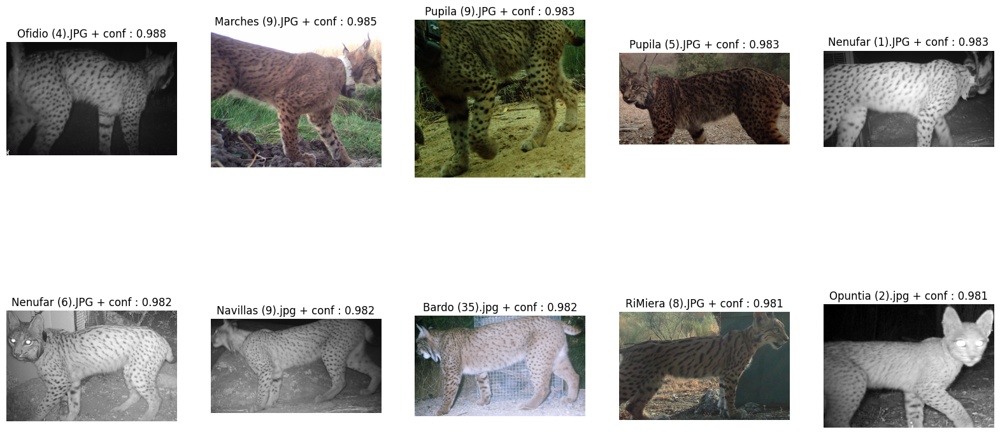

In [20]:
plot_images_conf(df_bbox_country_single_detection, by="largest")

In [21]:
df_country_with_bbox = pd.merge(df_country, df_bbox_country_single_detection[['file', 'conf', 'x', 'y', 'width', 'height']], how='inner', left_on='filepath', right_on='file')
df_country_with_bbox = df_country_with_bbox.drop('file', axis=1)

df_country_with_bbox

,filepath,lynx_id,conf,x,y,width,height
0,/gpfsscratch/rech/ads/commun/datasets/extracte...,Arce,0.964,1342.97600,557.95200,890.8800,586.9440
1,/gpfsscratch/rech/ads/commun/datasets/extracte...,Mural,0.979,432.96768,0.00000,3847.6800,2487.8080
2,/gpfsscratch/rech/ads/commun/datasets/extracte...,Betis,0.964,385.88400,84.98682,630.8280,524.8800
3,/gpfsscratch/rech/ads/commun/datasets/extracte...,NinfaMt,0.951,20.99190,252.98400,933.9642,503.9868
4,/gpfsscratch/rech/ads/commun/datasets/extracte...,Mosto,0.956,278.78400,315.84000,2185.9840,1411.9680
...,...,...,...,...,...,...,...
1531,/gpfsscratch/rech/ads/commun/datasets/extracte...,Malabar,0.905,0.00000,15.99942,822.9288,426.9781
1532,/gpfsscratch/rech/ads/commun/datasets/extracte...,Arce,0.892,71.99744,315.95520,464.9984,320.9472
1533,/gpfsscratch/rech/ads/commun/datasets/extracte...,Piqueros,0.956,334.97600,209.95200,419.9680,214.9920
1534,/gpfsscratch/rech/ads/commun/datasets/extracte...,RELICTO,0.826,73.99775,14.99706,774.9505,733.9436


#### Bounding box confidence distribution

<Axes: xlabel='conf', ylabel='Count'>

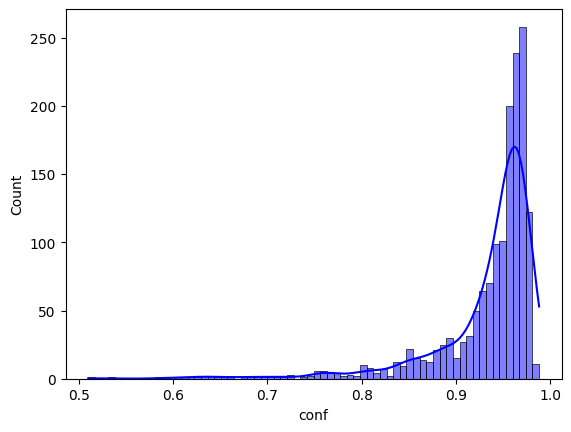

In [22]:
import seaborn as sns

sns.histplot(df_country_with_bbox["conf"], kde=True, color='blue')

## **Compute `image_number` for each individual**

This number is no longer the same as initially following filtering, particularly of images with no bounding box detected, for example.

In [23]:
df_country_with_bbox['image_number'] = df_country_with_bbox.groupby('lynx_id').cumcount() + 1
df_country_with_bbox

,filepath,lynx_id,conf,x,y,width,height,image_number
0,/gpfsscratch/rech/ads/commun/datasets/extracte...,Arce,0.964,1342.97600,557.95200,890.8800,586.9440,1
1,/gpfsscratch/rech/ads/commun/datasets/extracte...,Mural,0.979,432.96768,0.00000,3847.6800,2487.8080,1
2,/gpfsscratch/rech/ads/commun/datasets/extracte...,Betis,0.964,385.88400,84.98682,630.8280,524.8800,1
3,/gpfsscratch/rech/ads/commun/datasets/extracte...,NinfaMt,0.951,20.99190,252.98400,933.9642,503.9868,1
4,/gpfsscratch/rech/ads/commun/datasets/extracte...,Mosto,0.956,278.78400,315.84000,2185.9840,1411.9680,1
...,...,...,...,...,...,...,...,...
1531,/gpfsscratch/rech/ads/commun/datasets/extracte...,Malabar,0.905,0.00000,15.99942,822.9288,426.9781,9
1532,/gpfsscratch/rech/ads/commun/datasets/extracte...,Arce,0.892,71.99744,315.95520,464.9984,320.9472,35
1533,/gpfsscratch/rech/ads/commun/datasets/extracte...,Piqueros,0.956,334.97600,209.95200,419.9680,214.9920,9
1534,/gpfsscratch/rech/ads/commun/datasets/extracte...,RELICTO,0.826,73.99775,14.99706,774.9505,733.9436,6


## **Add other information**

In [24]:
df_country_with_bbox['country'] = COUNTRY
df_country_with_bbox['source'] = np.nan
df_country_with_bbox['pattern'] = np.nan
df_country_with_bbox['date'] = np.nan
df_country_with_bbox['location'] = np.nan

In [25]:
df_country_with_bbox.to_csv(DATASET / COUNTRY / f"lynx_dataset_{COUNTRY}.csv", index=False)

## **Remove backgrounds**

Images without backgrounds are calculated using the `Segment Anything Model`. These are saved here: `/gpfsscratch/rech/ads/commun/datasets/extracted/no_background`.  
The csv file is completed with a `filepath_no_bg` column and saved here: `/gpfsscratch/rech/ads/commun/datasets/extracted/lynx_dataset_full_no_bg.csv`

In [179]:
df_country_with_bbox = pd.read_csv(DATASET / f"{COUNTRY}" / f"lynx_dataset_{COUNTRY}.csv")

### **Add the `filepath_no_bg` column based on existing images**

In [180]:
df_country_with_bbox['filepath_no_bg'] = df_country_with_bbox.apply(lambda row: check_filepath(NO_BACKGROUND, COUNTRY, row['filepath'], row['lynx_id'], row['image_number']), axis=1)

In [181]:
print(f"Number of images remaining to be calculated: {df_country_with_bbox['filepath_no_bg'].isna().sum()}")

Number of images remaining to be calculated: 1536


In [182]:
df_country_with_bbox.to_csv(DATASET / COUNTRY / f"lynx_dataset_{COUNTRY}.csv", index=False)

In [184]:
display_slurm_queue(name=f'sam_{COUNTRY}', timestep=60)

             JOBID PARTITION     NAME     USER ST       TIME  NODES NODELIST(REASON)
            350802   gpu_p13 sam_spai  uxp55sd  R      20:02      1 r6i2n8

 Done!


In [7]:
df_full = pd.read_csv(DATASET / f"{COUNTRY}" / f"lynx_dataset_{COUNTRY}.csv")

In [8]:
df_full.groupby('country').nunique()[['filepath', 'filepath_no_bg']]

,filepath,filepath_no_bg
country,,
spain,1536,1536


In [9]:
all_files_exist = df_full['filepath_no_bg'].apply(lambda x: pd.isna(x) or os.path.exists(x)).all()
assert all_files_exist

## **Handle duplicates**

In [10]:
pd.set_option('display.max_colwidth', None)

In [11]:
df_full['basename'] = df_full['filepath'].apply(os.path.basename)
df_full[df_full.duplicated(subset='basename', keep=False)]

,filepath,lynx_id,conf,x,y,width,height,image_number,country,source,pattern,date,location,filepath_no_bg,score_sam,basename


In [210]:
df_full.index[df_full['score_sam'].between(0.7, 0.75)].tolist()

[172, 223, 344, 447, 507, 589, 932, 1156, 1501, 1525]

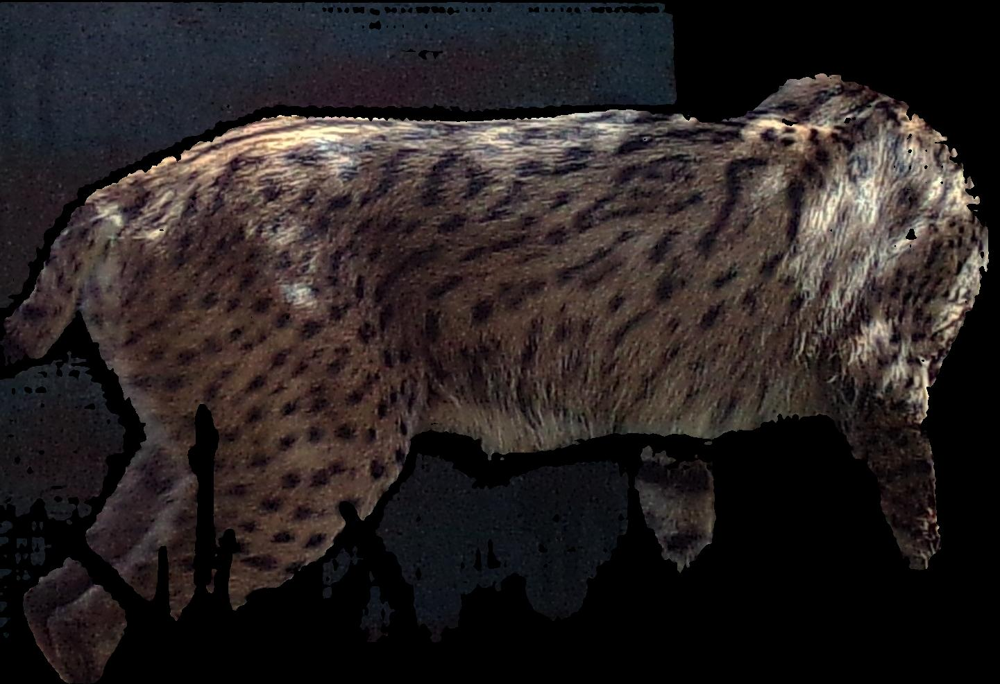

In [220]:
Image.open(df_full.iloc[1525]['filepath_no_bg'])

## **Manual post-processing of segmented images**

In [62]:
df_full = pd.read_csv(DATASET / f"{COUNTRY}" / f"lynx_dataset_{COUNTRY}.csv")

In [176]:
index_images_to_inverse = pd.Index(df_full['filepath_no_bg']).get_indexer([
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Bardo/no_bg_13_Bardo (1).jpg',
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Indie/no_bg_2_Indie (8).jpg',
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Inri/no_bg_4_Inri (3).jpg',  # to be deleted: 359
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Inri/no_bg_3_Inri (6).jpg',
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Karma/no_bg_4_Karma (6).jpg',  # to be deleted: 705
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Karma/no_bg_5_Karma (1).JPG',  # to be deleted: 708
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Karma/no_bg_7_Karma (9).JPG',  # to be deleted: 1164
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Kea/no_bg_3_Kea (7).JPG',
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Kendo/no_bg_3_Kendo (13).jpg',
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Kentaro/no_bg_1_Kentaro (1).JPG',
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Kiki/no_bg_8_Kiki (1).png',
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Kiki/no_bg_9_Kiki (2).png',
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Kiowa/no_bg_5_Kiowa (2).png',  # to be deleted: 636
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Kiowa/no_bg_7_Kiowa (1).png',
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Lava/no_bg_3_Lava (9).JPG',
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Lava/no_bg_6_Lava (1).JPG',  # to be deleted: 1036
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Llerena/no_bg_3_Llerena (10).JPG',  # to be deleted: 657
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Llerena/no_bg_4_Llerena (8).JPG',
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Llerena/no_bg_5_Llerena (9).JPG',
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Llerena/no_bg_7_Llerena (4).JPG',
    '/gpfsscratch/rech/ads/commun/datasets/extracted/no_background_new/spain/Luna/no_bg_6_Luna (3).JPG',  # to be deleted: 898
])
index_images_to_inverse

array([ 495, 1008,  359,  310,  705,  708, 1164,  191,  420,  217,  641,
        743,  636, 1058,  556, 1036,  657,  987,  990, 1358,  898])

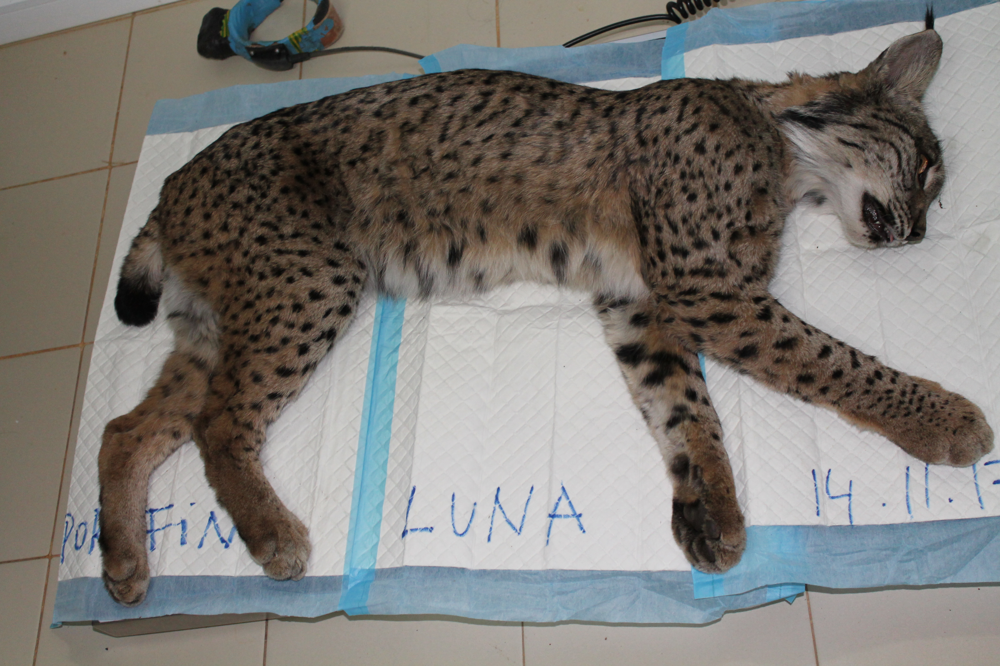

In [177]:
idx = 898

Image.open(df_full.iloc[idx]['filepath'])

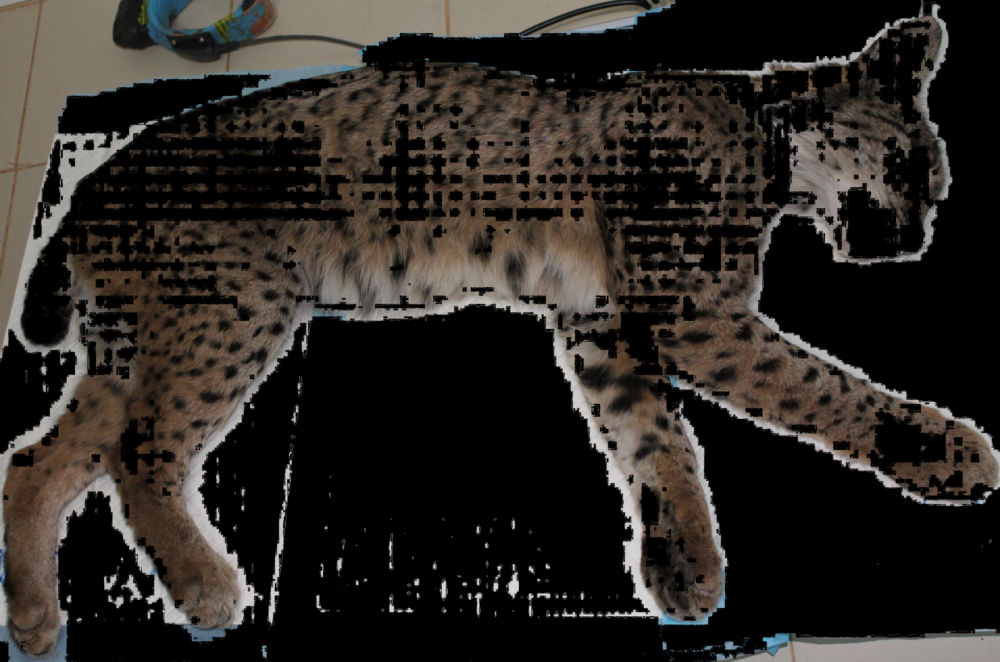

In [178]:
image_inverse, base_img = segmentation_inversion(df_full.iloc[idx], save_new_img=False)
image_inverse

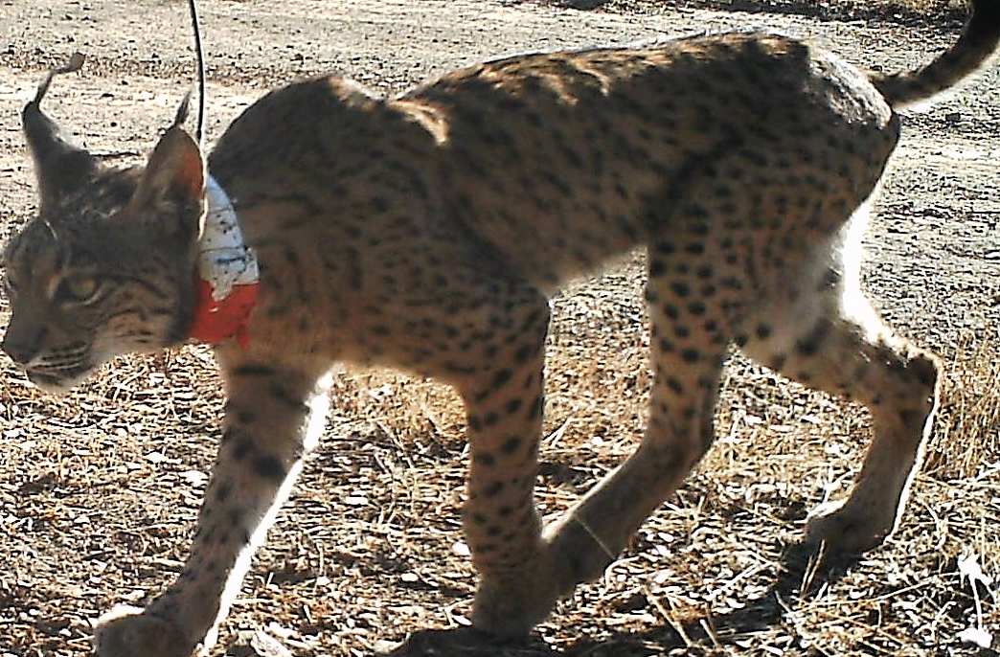

In [175]:
base_img

In [93]:
# df_full.drop(index=310, inplace=True)